In [1]:
from tensorflow.keras.layers import Conv2D, BatchNormalization, Activation, MaxPool2D, Conv2DTranspose, Concatenate, Input
from tensorflow.keras.models import Model

def conv_block(inputs, num_filters):
    x = Conv2D(num_filters, 3, padding="same")(inputs)
    x = BatchNormalization()(x)
    x = Activation("relu")(x)

    x = Conv2D(num_filters, 3, padding="same")(x)
    x = BatchNormalization()(x)
    x = Activation("relu")(x)

    return x

def encoder_block(inputs, num_filters):
    x = conv_block(inputs, num_filters)
    p = MaxPool2D((2, 2))(x)
    return x, p

def decoder_block(inputs, skip_features, num_filters):
    x = Conv2DTranspose(num_filters, (2, 2), strides=2, padding="same")(inputs)
    x = Concatenate()([x, skip_features])
    x = conv_block(x, num_filters)
    return x

def build_unet(input_shape):
    inputs = Input(input_shape)

    """ Encoder """
    s1, p1 = encoder_block(inputs, 64)
    s2, p2 = encoder_block(p1, 128)
    s3, p3 = encoder_block(p2, 256)
    s4, p4 = encoder_block(p3, 512)

    """ Bridge """
    b1 = conv_block(p4, 1024)

    """ Decoder """
    d1 = decoder_block(b1, s4, 512)
    d2 = decoder_block(d1, s3, 256)
    d3 = decoder_block(d2, s2, 128)
    d4 = decoder_block(d3, s1, 64)

    """ Outputs """
    outputs = Conv2D(1, 1, padding="same", activation="sigmoid")(d4)

    """ Model """
    model = Model(inputs, outputs)
    return model

2024-03-06 15:26:07.509915: I tensorflow/core/util/port.cc:111] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2024-03-06 15:26:07.707281: E tensorflow/compiler/xla/stream_executor/cuda/cuda_dnn.cc:9342] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-03-06 15:26:07.707346: E tensorflow/compiler/xla/stream_executor/cuda/cuda_fft.cc:609] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-03-06 15:26:07.708488: E tensorflow/compiler/xla/stream_executor/cuda/cuda_blas.cc:1518] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-03-06 15:26:07.792027: I tensorflow/core/platform/cpu_feature_g

In [6]:

import numpy as np
import tensorflow as tf
from tensorflow.keras import backend as K

def iou(y_true, y_pred):
    def f(y_true, y_pred):
        intersection = (y_true * y_pred).sum()
        union = y_true.sum() + y_pred.sum() - intersection
        x = (intersection + 1e-15) / (union + 1e-15)
        x = x.astype(np.float32)
        return x
    return tf.numpy_function(f, [y_true, y_pred], tf.float32)

smooth = 1e-15
def dice_coef(y_true, y_pred):
    y_true = tf.keras.layers.Flatten()(y_true)
    y_pred = tf.keras.layers.Flatten()(y_pred)
    intersection = tf.reduce_sum(y_true * y_pred)
    return (2. * intersection + smooth) / (tf.reduce_sum(y_true) + tf.reduce_sum(y_pred) + smooth)

def dice_loss(y_true, y_pred):
    return 1.0 - dice_coef(y_true, y_pred)

In [7]:

import os
os.environ["TF_CPP_MIN_LOG_LEVEL"] = "2"
import numpy as np
import cv2
from glob import glob
from sklearn.utils import shuffle
from sklearn.model_selection import train_test_split
import tensorflow as tf
from tensorflow.keras.callbacks import ModelCheckpoint, CSVLogger, ReduceLROnPlateau, EarlyStopping, TensorBoard
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.metrics import Recall, Precision


H = 256
W = 256

def create_dir(path):
    if not os.path.exists(path):
        os.makedirs(path)

def shuffling(x, y):
    x, y = shuffle(x, y, random_state=42)
    return x, y

def load_data(dataset_path, split=0.2):
    images = sorted(glob(os.path.join(dataset_path, "xtrain", "*.jpg")))
    masks = sorted(glob(os.path.join(dataset_path, "ytrain", "*.png")))

    test_size = int(len(images) * split)

    train_x, valid_x = train_test_split(images, test_size=test_size, random_state=42)
    train_y, valid_y = train_test_split(masks, test_size=test_size, random_state=42)

    train_x, test_x = train_test_split(train_x, test_size=test_size, random_state=42)
    train_y, test_y = train_test_split(train_y, test_size=test_size, random_state=42)

    return (train_x, train_y), (valid_x, valid_y), (test_x, test_y)

def read_image(path):
    path = path.decode()
    x = cv2.imread(path, cv2.IMREAD_COLOR)  ## (H, W, 3)
    x = cv2.resize(x, (W, H))
    x = x/255.0
    x = x.astype(np.float32)
    return x                                ## (256, 256, 3)

def read_mask(path):
    path = path.decode()
    x = cv2.imread(path, cv2.IMREAD_GRAYSCALE)  ## (H, W)
    x = cv2.resize(x, (W, H))
    x = x/255.0
    x = x.astype(np.float32)                    ## (256, 256)
    x = np.expand_dims(x, axis=-1)              ## (256, 256, 1)
    return x

def tf_parse(x, y):
    def _parse(x, y):
        x = read_image(x)
        y = read_mask(y)
        return x, y

    x, y = tf.numpy_function(_parse, [x, y], [tf.float32, tf.float32])
    x.set_shape([H, W, 3])
    y.set_shape([H, W, 1])
    return x, y

def tf_dataset(X, Y, batch):
    dataset = tf.data.Dataset.from_tensor_slices((X, Y))
    dataset = dataset.map(tf_parse)
    dataset = dataset.batch(batch)
    dataset = dataset.prefetch(10)
    return dataset

if __name__ == "__main__":
    """ Seeding """
    np.random.seed(42)
    tf.random.set_seed(42)

    """ Folder for saving data """
    create_dir("files")

    """ Hyperparameters """
    batch_size = 4
    lr = 1e-4 ## (0.0001)
    num_epoch = 5
    model_path = "/home/umair123/dataset/model.h5"
    csv_path = "/home/umair123/dataset/data.csv"

    """ Dataset : 60/20/20 """
    dataset_path = "/home/umair123/dataset/"
    (train_x, train_y), (valid_x, valid_y), (test_x, test_y) = load_data(dataset_path)

    print(f"Train: {len(train_x)} - {len(train_y)}")
    print(f"Valid: {len(valid_x)} - {len(valid_y)}")
    print(f"Test: {len(test_x)} - {len(test_y)}")

    train_dataset = tf_dataset(train_x, train_y, batch_size)
    valid_dataset = tf_dataset(valid_x, valid_y, batch_size)

    train_steps = len(train_x)//batch_size
    valid_steps = len(valid_x)//batch_size

    if len(train_x) % batch_size != 0:
        train_steps += 1

    if len(valid_x) % batch_size != 0:
        valid_steps += 1

    """ Model """
    model = build_unet((H, W, 3))
    metrics = [dice_coef, iou, Recall(), Precision()]
    model.compile(loss="binary_crossentropy", optimizer=Adam(lr), metrics=metrics)
    model.summary()

    callbacks = [
        ModelCheckpoint(model_path, verbose=1, save_best_only=True),
        ReduceLROnPlateau(monitor='val_loss', factor=0.1, patience=5, min_lr=1e-7, verbose=1),
        CSVLogger(csv_path),
        TensorBoard(),
        EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=False)
    ]

    model.fit(
        train_dataset,
        epochs=num_epoch,
        validation_data=valid_dataset,
        steps_per_epoch=train_steps,
        validation_steps=valid_steps,
        callbacks=callbacks
    )

Train: 540 - 540
Valid: 180 - 180
Test: 180 - 180


2024-03-06 15:29:10.632129: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:880] could not open file to read NUMA node: /sys/bus/pci/devices/0000:01:00.0/numa_node
Your kernel may have been built without NUMA support.
2024-03-06 15:29:10.739087: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:880] could not open file to read NUMA node: /sys/bus/pci/devices/0000:01:00.0/numa_node
Your kernel may have been built without NUMA support.
2024-03-06 15:29:10.739159: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:880] could not open file to read NUMA node: /sys/bus/pci/devices/0000:01:00.0/numa_node
Your kernel may have been built without NUMA support.
2024-03-06 15:29:10.742508: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:880] could not open file to read NUMA node: /sys/bus/pci/devices/0000:01:00.0/numa_node
Your kernel may have been built without NUMA support.
2024-03-06 15:29:10.742572: I tensorflow/compile

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 256, 256, 3)]        0         []                            
                                                                                                  
 conv2d (Conv2D)             (None, 256, 256, 64)         1792      ['input_1[0][0]']             
                                                                                                  
 batch_normalization (Batch  (None, 256, 256, 64)         256       ['conv2d[0][0]']              
 Normalization)                                                                                   
                                                                                                  
 activation (Activation)     (None, 256, 256, 64)         0         ['batch_normalization[0][0

2024-03-06 15:29:12.491358: I tensorflow/tsl/platform/default/subprocess.cc:304] Start cannot spawn child process: No such file or directory


Epoch 1/5


2024-03-06 15:29:17.874451: I tensorflow/compiler/xla/stream_executor/cuda/cuda_dnn.cc:442] Loaded cuDNN version 8700
2024-03-06 15:29:19.071893: I tensorflow/tsl/platform/default/subprocess.cc:304] Start cannot spawn child process: No such file or directory
2024-03-06 15:29:22.433178: I tensorflow/compiler/xla/service/service.cc:168] XLA service 0x7f1218979f40 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
2024-03-06 15:29:22.433241: I tensorflow/compiler/xla/service/service.cc:176]   StreamExecutor device (0): NVIDIA GeForce RTX 4060 Laptop GPU, Compute Capability 8.9
2024-03-06 15:29:22.440444: I tensorflow/compiler/mlir/tensorflow/utils/dump_mlir_util.cc:269] disabling MLIR crash reproducer, set env var `MLIR_CRASH_REPRODUCER_DIRECTORY` to enable.
2024-03-06 15:29:22.519238: I ./tensorflow/compiler/jit/device_compiler.h:186] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.
2024-03-06 15:29:29.325

135/135 [==============================] - ETA: 0s - loss: 0.5152 - dice_coef: 0.5223 - iou: 0.3585 - recall: 0.6948 - precision: 0.6070
Epoch 1: val_loss improved from inf to 0.55971, saving model to /home/umair123/dataset/model.h5


/home/umair123/anaconda3/envs/py310/lib/python3.11/site-packages/keras/src/engine/training.py:3079: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


135/135 [==============================] - 46s 203ms/step - loss: 0.5152 - dice_coef: 0.5223 - iou: 0.3585 - recall: 0.6948 - precision: 0.6070 - val_loss: 0.5597 - val_dice_coef: 0.2634 - val_iou: 0.1527 - val_recall: 0.0000e+00 - val_precision: 0.0000e+00 - lr: 1.0000e-04
Epoch 2/5
135/135 [==============================] - ETA: 0s - loss: 0.3490 - dice_coef: 0.6100 - iou: 0.4433 - recall: 0.7368 - precision: 0.8096
Epoch 2: val_loss improved from 0.55971 to 0.42112, saving model to /home/umair123/dataset/model.h5
135/135 [==============================] - 27s 198ms/step - loss: 0.3490 - dice_coef: 0.6100 - iou: 0.4433 - recall: 0.7368 - precision: 0.8096 - val_loss: 0.4211 - val_dice_coef: 0.4380 - val_iou: 0.2833 - val_recall: 0.3274 - val_precision: 0.9447 - lr: 1.0000e-04
Epoch 3/5
135/135 [==============================] - ETA: 0s - loss: 0.2940 - dice_coef: 0.6566 - iou: 0.4932 - recall: 0.7766 - precision: 0.8474
Epoch 3: val_loss improved from 0.42112 to 0.34085, saving model

In [11]:
test_x

['/home/umair123/dataset/xtrain/ISIC_0011203.jpg',
 '/home/umair123/dataset/xtrain/ISIC_0011145.jpg',
 '/home/umair123/dataset/xtrain/ISIC_0000387.jpg',
 '/home/umair123/dataset/xtrain/ISIC_0009995.jpg',
 '/home/umair123/dataset/xtrain/ISIC_0000223.jpg',
 '/home/umair123/dataset/xtrain/ISIC_0006021.jpg',
 '/home/umair123/dataset/xtrain/ISIC_0005620.jpg',
 '/home/umair123/dataset/xtrain/ISIC_0006350.jpg',
 '/home/umair123/dataset/xtrain/ISIC_0000085.jpg',
 '/home/umair123/dataset/xtrain/ISIC_0009934.jpg',
 '/home/umair123/dataset/xtrain/ISIC_0008347.jpg',
 '/home/umair123/dataset/xtrain/ISIC_0010247.jpg',
 '/home/umair123/dataset/xtrain/ISIC_0007788.jpg',
 '/home/umair123/dataset/xtrain/ISIC_0011327.jpg',
 '/home/umair123/dataset/xtrain/ISIC_0000179.jpg',
 '/home/umair123/dataset/xtrain/ISIC_0011135.jpg',
 '/home/umair123/dataset/xtrain/ISIC_0010251.jpg',
 '/home/umair123/dataset/xtrain/ISIC_0000421.jpg',
 '/home/umair123/dataset/xtrain/ISIC_0010493.jpg',
 '/home/umair123/dataset/xtrain

  0%|          | 0/180 [00:00<?, ?it/s]

1/1 [==============================] - 0s 273ms/step


  1%|          | 1/180 [00:00<01:28,  2.02it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 3/180 [00:01<01:53,  1.57it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 5/180 [00:02<01:02,  2.82it/s]

1/1 [==============================] - 0s 26ms/step


  3%|▎         | 6/180 [00:02<00:56,  3.08it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 7/180 [00:02<00:48,  3.57it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 8/180 [00:02<00:42,  4.05it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▌         | 9/180 [00:02<00:36,  4.66it/s]

1/1 [==============================] - 0s 30ms/step


  6%|▌         | 10/180 [00:02<00:30,  5.49it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 11/180 [00:03<00:33,  5.12it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 12/180 [00:03<00:28,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 13/180 [00:03<00:31,  5.34it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 15/180 [00:03<00:24,  6.86it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 17/180 [00:03<00:20,  7.79it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 18/180 [00:03<00:22,  7.22it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 20/180 [00:04<00:19,  8.10it/s]

1/1 [==============================] - 0s 24ms/step


/tmp/ipykernel_12399/2711210871.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(16,16))
 12%|█▏        | 21/180 [00:04<00:18,  8.40it/s]

1/1 [==============================] - 0s 16ms/step


 12%|█▏        | 22/180 [00:04<00:18,  8.73it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 24/180 [00:04<00:19,  8.21it/s]

1/1 [==============================] - 0s 16ms/step


 14%|█▍        | 26/180 [00:04<00:17,  8.89it/s]

1/1 [==============================] - 0s 16ms/step


 15%|█▌        | 27/180 [00:04<00:16,  9.06it/s]

1/1 [==============================] - 0s 31ms/step


 16%|█▌        | 29/180 [00:05<00:18,  7.98it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 31/180 [00:05<00:17,  8.64it/s]

1/1 [==============================] - 0s 16ms/step


 18%|█▊        | 32/180 [00:05<00:16,  8.82it/s]

1/1 [==============================] - 0s 17ms/step


 19%|█▉        | 34/180 [00:05<00:15,  9.29it/s]

1/1 [==============================] - 0s 17ms/step


 20%|██        | 36/180 [00:05<00:15,  9.08it/s]

1/1 [==============================] - 0s 17ms/step


 21%|██        | 37/180 [00:06<00:17,  8.23it/s]

1/1 [==============================] - 0s 17ms/step


 21%|██        | 38/180 [00:06<00:16,  8.42it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 40/180 [00:06<00:15,  9.12it/s]

1/1 [==============================] - 0s 17ms/step


 23%|██▎       | 42/180 [00:06<00:14,  9.52it/s]

1/1 [==============================] - 0s 17ms/step


 24%|██▍       | 43/180 [00:06<00:14,  9.61it/s]

1/1 [==============================] - 0s 15ms/step


 24%|██▍       | 44/180 [00:06<00:14,  9.68it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 46/180 [00:07<00:13,  9.81it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 47/180 [00:07<00:15,  8.58it/s]

1/1 [==============================] - 0s 17ms/step


 27%|██▋       | 49/180 [00:07<00:14,  9.25it/s]

1/1 [==============================] - 0s 16ms/step


 28%|██▊       | 50/180 [00:07<00:15,  8.60it/s]

1/1 [==============================] - 0s 17ms/step


 28%|██▊       | 51/180 [00:07<00:14,  8.89it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 52/180 [00:07<00:14,  9.02it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 53/180 [00:07<00:13,  9.24it/s]

1/1 [==============================] - 0s 16ms/step


 30%|███       | 54/180 [00:08<00:15,  7.97it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███       | 56/180 [00:08<00:14,  8.73it/s]

1/1 [==============================] - 0s 25ms/step


 32%|███▏      | 57/180 [00:08<00:13,  8.86it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 58/180 [00:08<00:13,  9.10it/s]

1/1 [==============================] - 0s 16ms/step


 33%|███▎      | 60/180 [00:08<00:12,  9.61it/s]

1/1 [==============================] - 0s 18ms/step


 34%|███▍      | 62/180 [00:08<00:12,  9.17it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 64/180 [00:09<00:21,  5.42it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 66/180 [00:09<00:17,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 68/180 [00:09<00:15,  7.14it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 69/180 [00:10<00:15,  7.24it/s]

1/1 [==============================] - 0s 16ms/step


 39%|███▉      | 70/180 [00:10<00:14,  7.45it/s]

1/1 [==============================] - 0s 17ms/step


 39%|███▉      | 71/180 [00:10<00:14,  7.63it/s]

1/1 [==============================] - 0s 16ms/step


 41%|████      | 73/180 [00:10<00:15,  6.93it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 75/180 [00:10<00:12,  8.38it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 77/180 [00:11<00:13,  7.76it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 79/180 [00:11<00:11,  8.42it/s]

1/1 [==============================] - 0s 17ms/step


 45%|████▌     | 81/180 [00:11<00:10,  9.40it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 83/180 [00:11<00:12,  7.77it/s]

1/1 [==============================] - 0s 16ms/step


 47%|████▋     | 85/180 [00:11<00:10,  8.92it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 87/180 [00:12<00:10,  8.67it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 89/180 [00:12<00:09,  9.28it/s]

1/1 [==============================] - 0s 18ms/step


 50%|█████     | 90/180 [00:12<00:10,  8.54it/s]

1/1 [==============================] - 0s 16ms/step


 51%|█████     | 91/180 [00:12<00:12,  7.13it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 93/180 [00:12<00:10,  8.16it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 95/180 [00:13<00:09,  8.89it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 96/180 [00:13<00:11,  7.27it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▍    | 98/180 [00:13<00:09,  8.31it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 100/180 [00:13<00:08,  8.95it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 102/180 [00:13<00:08,  9.05it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 103/180 [00:14<00:10,  7.53it/s]

1/1 [==============================] - 0s 16ms/step


 58%|█████▊    | 105/180 [00:14<00:08,  8.46it/s]

1/1 [==============================] - 0s 19ms/step


 59%|█████▉    | 107/180 [00:14<00:08,  9.07it/s]

1/1 [==============================] - 0s 17ms/step


 60%|██████    | 108/180 [00:14<00:07,  9.18it/s]

1/1 [==============================] - 0s 17ms/step


 61%|██████    | 109/180 [00:14<00:08,  8.22it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 111/180 [00:14<00:07,  8.96it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 113/180 [00:15<00:07,  9.55it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 115/180 [00:15<00:06,  9.50it/s]

1/1 [==============================] - 0s 17ms/step


 65%|██████▌   | 117/180 [00:15<00:06,  9.87it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▌   | 119/180 [00:15<00:05, 10.22it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 121/180 [00:16<00:07,  8.26it/s]

1/1 [==============================] - 0s 16ms/step


 68%|██████▊   | 122/180 [00:16<00:07,  7.89it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 123/180 [00:16<00:07,  7.94it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 124/180 [00:16<00:06,  8.27it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 125/180 [00:16<00:07,  7.76it/s]

1/1 [==============================] - 0s 17ms/step


 71%|███████   | 127/180 [00:16<00:06,  8.74it/s]

1/1 [==============================] - 0s 17ms/step


 72%|███████▏  | 129/180 [00:17<00:05,  9.58it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 131/180 [00:17<00:04, 10.09it/s]

1/1 [==============================] - 0s 27ms/step


 74%|███████▍  | 133/180 [00:17<00:05,  8.36it/s]

1/1 [==============================] - 0s 17ms/step


 75%|███████▌  | 135/180 [00:17<00:04,  9.29it/s]

1/1 [==============================] - 0s 30ms/step


 76%|███████▌  | 136/180 [00:17<00:04,  9.35it/s]

1/1 [==============================] - 0s 17ms/step


 77%|███████▋  | 138/180 [00:18<00:08,  5.03it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 140/180 [00:18<00:06,  6.07it/s]

1/1 [==============================] - 0s 17ms/step


 79%|███████▉  | 142/180 [00:18<00:05,  6.40it/s]

1/1 [==============================] - 0s 17ms/step


 79%|███████▉  | 143/180 [00:19<00:06,  6.15it/s]

1/1 [==============================] - 0s 16ms/step


 80%|████████  | 144/180 [00:19<00:05,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 145/180 [00:19<00:05,  6.40it/s]

1/1 [==============================] - 0s 17ms/step


 81%|████████  | 146/180 [00:19<00:04,  6.87it/s]

1/1 [==============================] - 0s 17ms/step


 82%|████████▏ | 147/180 [00:19<00:04,  7.24it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 149/180 [00:19<00:03,  8.84it/s]

1/1 [==============================] - 0s 16ms/step


 83%|████████▎ | 150/180 [00:19<00:03,  8.86it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 151/180 [00:20<00:04,  6.97it/s]

1/1 [==============================] - 0s 17ms/step


 84%|████████▍ | 152/180 [00:20<00:03,  7.22it/s]

1/1 [==============================] - 0s 19ms/step


 86%|████████▌ | 154/180 [00:20<00:02,  8.95it/s]

1/1 [==============================] - 0s 16ms/step


 87%|████████▋ | 156/180 [00:20<00:02, 10.21it/s]

1/1 [==============================] - 0s 16ms/step


 88%|████████▊ | 158/180 [00:20<00:02,  8.80it/s]

1/1 [==============================] - 0s 16ms/step


 89%|████████▉ | 160/180 [00:21<00:02,  9.86it/s]

1/1 [==============================] - 0s 18ms/step


 90%|█████████ | 162/180 [00:21<00:01, 10.69it/s]

1/1 [==============================] - 0s 17ms/step


 91%|█████████ | 164/180 [00:21<00:01, 11.30it/s]

1/1 [==============================] - 0s 16ms/step


 92%|█████████▏| 166/180 [00:21<00:01, 11.80it/s]

1/1 [==============================] - 0s 16ms/step


 93%|█████████▎| 168/180 [00:21<00:00, 12.14it/s]

1/1 [==============================] - 0s 16ms/step


 94%|█████████▍| 170/180 [00:21<00:00, 11.26it/s]

1/1 [==============================] - 0s 17ms/step


 96%|█████████▌| 172/180 [00:22<00:00, 11.55it/s]

1/1 [==============================] - 0s 16ms/step


 97%|█████████▋| 174/180 [00:22<00:00, 11.81it/s]

1/1 [==============================] - 0s 16ms/step


 98%|█████████▊| 176/180 [00:22<00:00, 12.04it/s]

1/1 [==============================] - 0s 17ms/step


 99%|█████████▉| 178/180 [00:22<00:00, 12.19it/s]

1/1 [==============================] - 0s 17ms/step


100%|██████████| 180/180 [00:22<00:00,  7.91it/s]


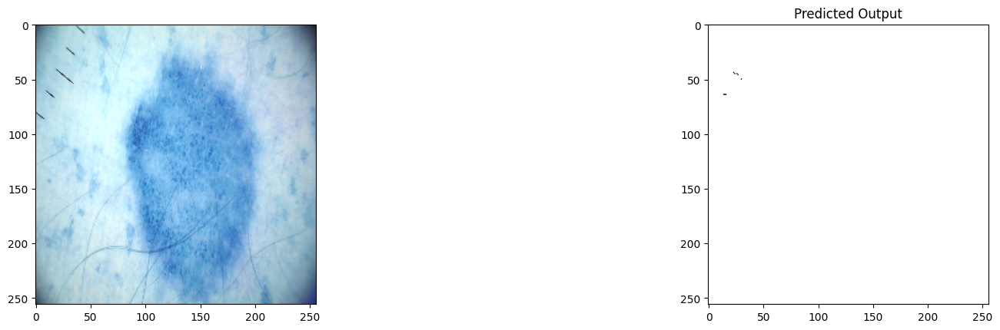

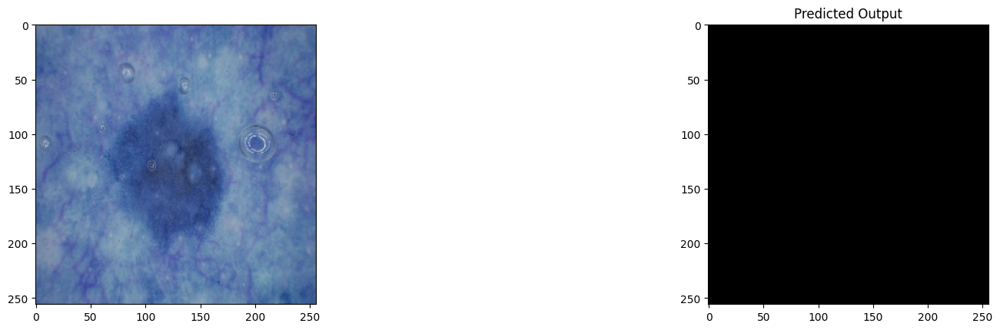

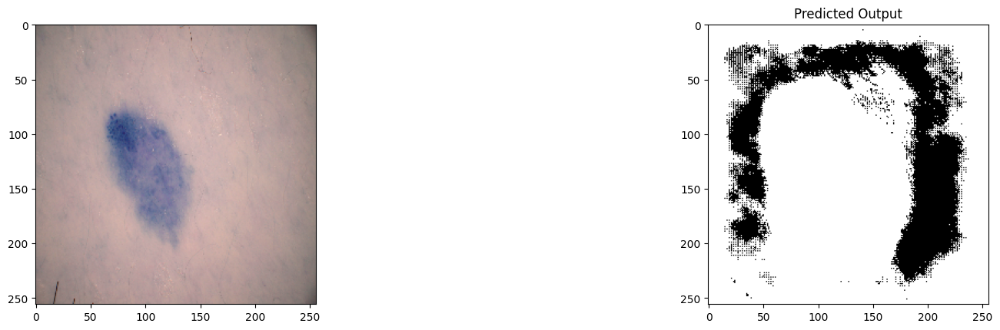

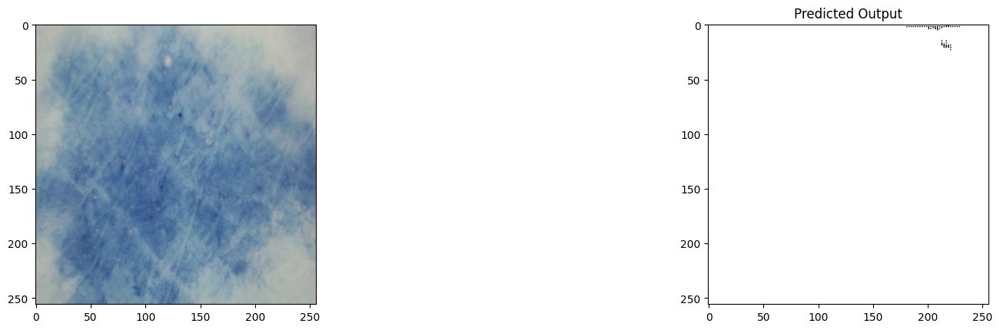

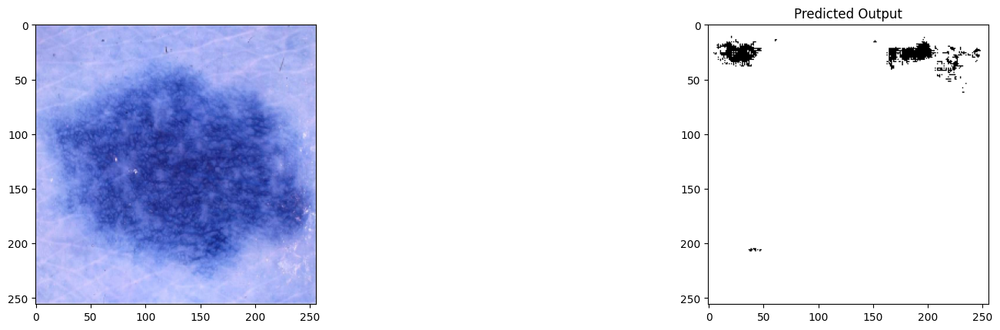

...

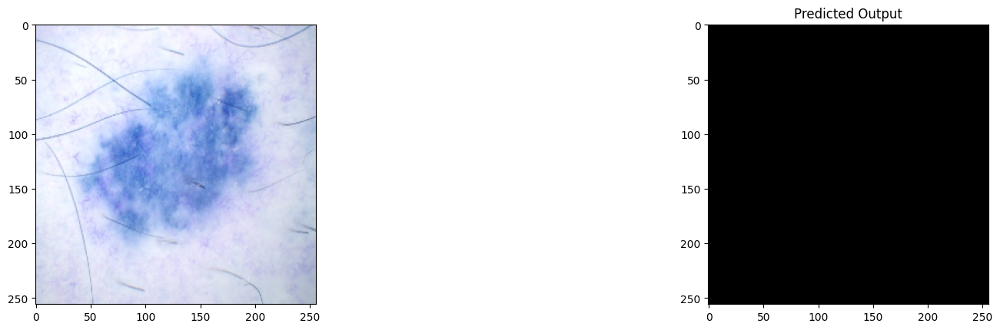

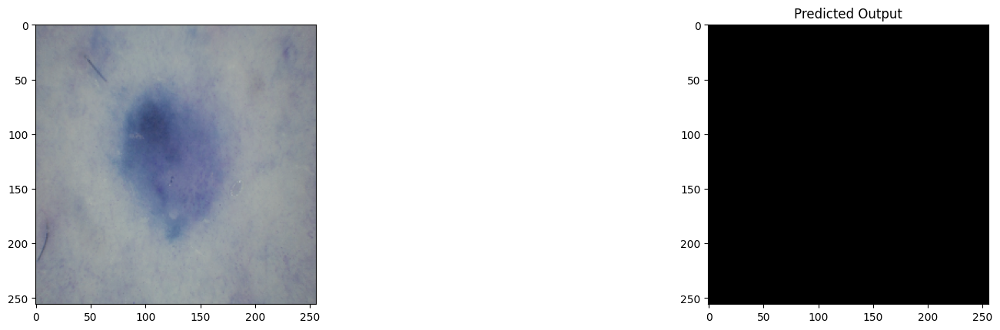

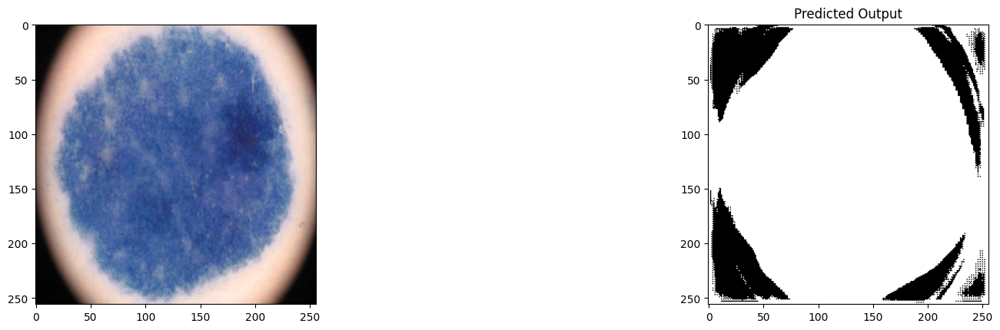

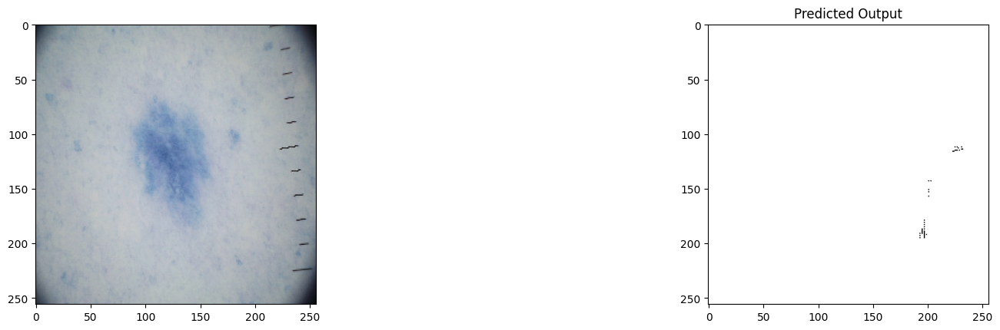

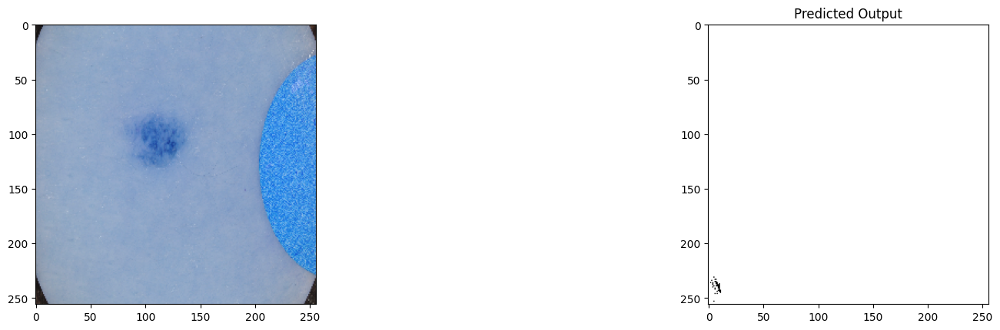

: 

In [20]:

import os
os.environ["TF_CPP_MIN_LOG_LEVEL"] = "2"
import numpy as np
import cv2
import pandas as pd
from glob import glob
from tqdm import tqdm
import tensorflow as tf
from tensorflow.keras.utils import CustomObjectScope
from sklearn.metrics import accuracy_score, f1_score, jaccard_score, precision_score, recall_score


H = 256
W = 256

def read_image(path):
    x = cv2.imread(path, cv2.IMREAD_COLOR)  ## (H, W, 3)
    x = cv2.resize(x, (W, H))
    ori_x = x
    x = x/255.0
    x = x.astype(np.float32)
    x = np.expand_dims(x, axis=0)
    return ori_x, x                                ## (1, 256, 256, 3)


def read_mask(path):
    x = cv2.imread(path, cv2.IMREAD_GRAYSCALE)  ## (H, W)
    x = cv2.resize(x, (W, H))
    ori_x = x
    x = x/255.0
    x = x.astype(np.int32)                    ## (256, 256)
    return ori_x, x

def save_results(ori_x, ori_y, y_pred, save_image_path):
    line = np.ones((H, 10, 3)) * 255

    ori_y = np.expand_dims(ori_y, axis=-1)  ## (256, 256, 1)
    ori_y = np.concatenate([ori_y, ori_y, ori_y], axis=-1) ## (256, 256, 3)

    y_pred = np.expand_dims(y_pred, axis=-1)  ## (256, 256, 1)
    y_pred = np.concatenate([y_pred, y_pred, y_pred], axis=-1) ## (256, 256, 3)

    cat_images = np.concatenate([ori_x, line, ori_y, line, y_pred*255], axis=1)
    cv2.imwrite(save_image_path, cat_images)


if __name__ == "__main__":
    """ Seeding """
    np.random.seed(42)
    tf.random.set_seed(42)

    """ Folder for saving results """
    create_dir("results")

    """ Load the model """
    with CustomObjectScope({'iou': iou, 'dice_coef': dice_coef}):
        model = tf.keras.models.load_model("/home/umair123/dataset/model.h5")

    """ Load the test data """
    dataset_path = "/home/umair123/dataset/"
    (train_x, train_y), (valid_x, valid_y), (test_x, test_y) = load_data(dataset_path)

    SCORE = []
    for x, y in tqdm(zip(test_x, test_y), total=len(test_x)):
        """ Exctracting the image name """
        name = x.split("/")[-1]

        """ Read the image and mask """
        ori_x, x = read_image(x)
        ori_y, y = read_mask(y)

        """ Predicting the mask """
        y_pred = model.predict(x)[0] > 0.05
        plt.figure(figsize=(16,16))
        plt.subplot(1,3,1)
        plt.imshow(x[0])
        plt.subplot(1,3,3)
        plt.imshow(y_pred, plt.cm.binary_r)
        plt.title('Predicted Output')
        # y_pred = np.squeeze(y_pred, axis=-1)
        # y_pred = y_pred.astype(np.int32)

        
        """ Saving the predicted mask """
        # save_image_path = f"results/{name}"
        # save_results(ori_x, ori_y, y_pred, save_image_path)

        # """ Flatten the array """
        # y = y.flatten()
        # y_pred = y_pred.flatten()

        # """ Calculating metrics values """
        # acc_value = accuracy_score(y, y_pred)
        # f1_value = f1_score(y, y_pred, labels=[0, 1], average="binary")
        # jac_value = jaccard_score(y, y_pred, labels=[0, 1], average="binary")
        # recall_value = recall_score(y, y_pred, labels=[0, 1], average="binary")
        # precision_value = precision_score(y, y_pred, labels=[0, 1], average="binary")
        # SCORE.append([name, acc_value, f1_value, jac_value, recall_value, precision_value])

    """ mean metrics values """
    # score = [s[1:] for s in SCORE]
    # score = np.mean(score, axis=0)
    # print(f"Accuracy: {score[0]:0.5f}")
    # print(f"F1: {score[1]:0.5f}")
    # print(f"Jaccard: {score[2]:0.5f}")
    # print(f"Recall: {score[3]:0.5f}")
    # print(f"Precision: {score[4]:0.5f}")

    # df = pd.DataFrame(SCORE, columns = ["Image Name", "Acc", "F1", "Jaccard", "Recall", "Precision"])
    # df.to_csv("files/score.csv")